# Starter pack

This notebook shows:

- how to load samples from PASTIS using the dataloaders provided in the repository.
- how to visualize the images
- compute the challenge metric
- make a random submission
- explain how your submissions will be processed automatically


## Imports

Clone the repo and tell Python where it is.

In [1]:
! git clone https://github.com/LouisStefanuto/hackathon-mines-invent-2024.git

Cloning into 'hackathon-mines-invent-2024'...
remote: Enumerating objects: 89, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 89 (delta 2), reused 1 (delta 1), pack-reused 84 (from 1)
Unpacking objects: 100% (89/89), 13.55 MiB | 9.66 MiB/s, done.


In [2]:
import sys

sys.path.append("/kaggle/working/hackathon-mines-invent-2024")

## Starter kit

In [3]:
# Fill these file paths with the locations on your machine.
PATH_TO_DATA = (
    #"/kaggle/input/data-challenge-invent-mines-2024/DATA-mini/DATA-mini"
     "/kaggle/input/data-challenge-invent-mines-2024/DATA/DATA/TRAIN"
)

The data folder should have this hierarchy:

```
.
├── TRAIN/
│   ├── DATA_S2/
│   │   ├── S2_10000.npy
│   │   ├── S2_10001.npy
│   │   ├── S2_10002.npy
│   │   └── ...
│   ├── ANNOTATIONS/
│   │   ├── TARGET_10000.npy
│   │   ├── TARGET_10001.npy
│   │   ├── TARGET_10002.npy
│   │   └── ...
│   └── metadata.json
└── TEST/
    ├── DATA_S2
    │   └── ...
    └── metadata.json
```


# GeoJson


The geojson file contains all the metadata about the patch sequences (id, dates of the sentinel 2 images, geometry of the parcels ...)

- ID: unique id of the patch
- N_Parcel: nb of parcels in the patch
- Parcel_Cover: % of the patch covered by land
- region: the patches are sampled from various regions, we added this information if you want to apply region-based normalization/transformations ...
- dates-S2: dates of the images in the sequence for this patch
- geometry: multipolygon shape telling where the parcels are


In [4]:
from pathlib import Path
import geopandas as gpd

METADATA = Path(PATH_TO_DATA) / "metadata.geojson"

mtd = gpd.read_file(METADATA)
mtd

,ID,TILE,N_Parcel,Parcel_Cover,dates-S2,geometry
0,10000,t30uxv,119,0.808032,"{'0': 20180924, '1': 20180929, '2': 20181004, ...","MULTIPOLYGON (((391504.736 6956805.915, 392781..."
1,10001,t30uxv,111,0.501986,"{'0': 20180924, '1': 20180929, '2': 20181004, ...","MULTIPOLYGON (((367628.562 6880296.822, 368905..."
2,10002,t30uxv,131,0.638722,"{'0': 20180924, '1': 20180929, '2': 20181004, ...","MULTIPOLYGON (((388950.375 6957003.181, 390227..."
3,10003,t30uxv,75,0.866824,"{'0': 20180924, '1': 20180929, '2': 20181004, ...","MULTIPOLYGON (((455228.326 6917189.740, 456504..."
4,10004,t30uxv,46,0.204906,"{'0': 20180924, '1': 20180929, '2': 20181004, ...","MULTIPOLYGON (((364779.509 6910052.243, 366056..."
...,...,...,...,...,...,...
1954,11954,t32ulu,412,0.593129,"{'0': 20180917, '1': 20180922, '2': 20180927, ...","MULTIPOLYGON (((1025974.352 6842342.142, 10272..."
1955,11955,t32ulu,120,0.802946,"{'0': 20180917, '1': 20180922, '2': 20180927, ...","MULTIPOLYGON (((1036872.407 6850881.525, 10381..."
1956,11956,t32ulu,33,0.783991,"{'0': 20180917, '1': 20180922, '2': 20180927, ...","MULTIPOLYGON (((977680.878 6836058.796, 978956..."
1957,11957,t32ulu,24,0.129896,"{'0': 20180917, '1': 20180922, '2': 20180927, ...","MULTIPOLYGON (((1018204.400 6759608.309, 10194..."


## Sentinel images - Loading and viz


In [5]:
import torch
import numpy as np
import pandas as pd

In [6]:
from baseline.dataset import BaselineDataset
from baseline.collate import pad_collate

# Set seeds for PyTorch and numpy
torch.manual_seed(1234)
np.random.seed(1234)

dt = BaselineDataset(Path(PATH_TO_DATA))

dl = torch.utils.data.DataLoader(
    dt, batch_size=32, collate_fn=pad_collate, shuffle=True
)

Reading patch metadata ...
Done.
Dataset ready.


Let's query a batch from the dataloader:


In [7]:
x, y = dl.__iter__().__next__()

Each batch is made of:

- an **image tensor** of shape $(B, T, C, H, W)$, where:
  - $B$ is the batch size
  - $T$ is the temporal length of the image time series
  - $(C, H, W)$ is the dimension of the patches, channel first
- a **label tensor** of shape $(B, H, W)$, the semantic segmentation ground truth mask (with values in $[0, 19]$)


In [8]:
print(x["S2"].shape)
print(y.shape)

torch.Size([32, 61, 10, 128, 128])
torch.Size([32, 128, 128])


/kaggle/working/hackathon-mines-invent-2024/baseline/viz.py:48: RuntimeWarning: invalid value encountered in divide
  im = (im - mi[:, None, None]) / (mx - mi)[:, None, None]
/opt/conda/lib/python3.10/site-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


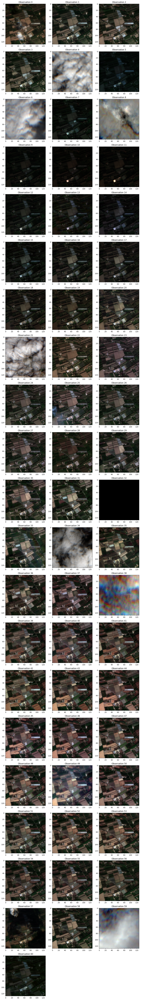

Image 0 - NDVI moyen : 0.561
Image 1 - NDVI moyen : 0.522
Image 2 - NDVI moyen : 0.538
Image 3 - NDVI moyen : 0.483
Image 4 - NDVI moyen : 0.134
Image 5 - NDVI moyen : 0.620
Image 6 - NDVI moyen : 0.021
Image 7 - NDVI moyen : 0.653
Image 8 - NDVI moyen : 0.121
Image 9 - NDVI moyen : 0.576
Image 10 - NDVI moyen : 0.610
Image 11 - NDVI moyen : 0.564
Image 12 - NDVI moyen : 0.552
Image 13 - NDVI moyen : 0.558
Image 14 - NDVI moyen : 0.595
Image 15 - NDVI moyen : 0.552
Image 16 - NDVI moyen : 0.538
Image 17 - NDVI moyen : 0.504
Image 18 - NDVI moyen : 0.513
Image 19 - NDVI moyen : 0.526
Image 20 - NDVI moyen : 0.475
Image 21 - NDVI moyen : 0.226
Image 22 - NDVI moyen : 0.433
Image 23 - NDVI moyen : 0.500
Image 24 - NDVI moyen : 0.488
Image 25 - NDVI moyen : 0.462
Image 26 - NDVI moyen : 0.479
Image 27 - NDVI moyen : 0.512
Image 28 - NDVI moyen : 0.533
Image 29 - NDVI moyen : 0.563
Image 30 - NDVI moyen : 0.508
Image 31 - NDVI moyen : 0.600
Image 32 - NDVI moyen : 0.000
Image 33 - NDVI moye

In [9]:
from baseline.viz import plot_sequence_grid
import torch
import numpy as np

def compute_ndvi(image):
    """
    Calculer l'indice NDVI pour une image satellite.
    NDVI = (NIR - RED) / (NIR + RED)
    Les canaux NIR et RED sont typiquement les bandes 8 et 4 dans les images Sentinel-2.
    """
    nir = image[6]  # Canal proche infrarouge (NIR)
    red = image[2]  # Canal rouge (RED)
    ndvi = (nir - red) / (nir + red + 1e-6) 
    return ndvi

def calculate_ndvi_means(x, bid=0):
    """
    Calculer le NDVI moyen pour chaque image d'une séquence temporelle.
    
    x: données d'entrée (tensor)
    bid: index du batch (pour sélectionner une séquence spécifique)
    
    Retourne une liste de NDVI moyens pour chaque image de la séquence.
    """
    sequence = x['S2'][bid]
    T, C, H, W = sequence.shape
    
    ndvi_means = []
    
    for t in range(T):
        ndvi = compute_ndvi(sequence[t])
        ndvi_mean = torch.mean(ndvi).item() 
        ndvi_means.append(ndvi_mean)
    
    return ndvi_means


IDX_SEQ = 1  

ndvi_means = calculate_ndvi_means(x, bid=IDX_SEQ)

plot_sequence_grid(x, bid=IDX_SEQ, N=21, M=3)

for i, ndvi_mean in enumerate(ndvi_means[:61]): 
    print(f"Image {i} - NDVI moyen : {ndvi_mean:.3f}")

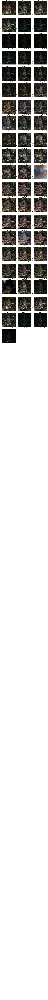

In [10]:
import torch

def remove_low_ndvi_images(x, ndvi_means, threshold, bid=0):
    """
    Supprimer les images dont le NDVI moyen est inférieur au seuil.

    x: données d'entrée (tensor)
    ndvi_means: liste des NDVI moyens pour chaque image
    threshold: seuil NDVI à utiliser pour supprimer les images
    bid: index du batch
    
    Retourne une nouvelle structure avec les images supprimées.
    """
    sequence = x['S2'][bid]
    T, C, H, W = sequence.shape

    valid_images = [sequence[t] for t, ndvi_mean in enumerate(ndvi_means) if ndvi_mean >= threshold]

    
    new_sequence = torch.stack(valid_images)

    new_x = x.copy() 
    new_x['S2'] = x['S2'].clone() 
    
    
    original_size = new_x['S2'][bid].shape[0]
    needed_size = original_size - new_sequence.shape[0]
    
    if needed_size >0:
        new_x['S2'][bid] = torch.cat((new_sequence, new_sequence[:needed_size]), dim=0)
    else:
        new_x['S2'][bid] = new_sequence

    return new_x

IDX_SEQ = 1  
ndvi_threshold = 0.3 


ndvi_means = calculate_ndvi_means(x, bid=IDX_SEQ)

x_filtered = remove_low_ndvi_images(x, ndvi_means, ndvi_threshold, bid=IDX_SEQ)

plot_sequence_grid(x_filtered, bid=IDX_SEQ, N=len(x_filtered['S2'][IDX_SEQ]), M=3)


In [11]:
ndvi_means_new = calculate_ndvi_means(x_filtered, bid=IDX_SEQ)


for i, ndvi_mean in enumerate(ndvi_means_new[:61]): 
    print(f"Image {i} - NDVI moyen : {ndvi_mean:.3f}")

Image 0 - NDVI moyen : 0.561
Image 1 - NDVI moyen : 0.522
Image 2 - NDVI moyen : 0.538
Image 3 - NDVI moyen : 0.483
Image 4 - NDVI moyen : 0.620
Image 5 - NDVI moyen : 0.653
Image 6 - NDVI moyen : 0.576
Image 7 - NDVI moyen : 0.610
Image 8 - NDVI moyen : 0.564
Image 9 - NDVI moyen : 0.552
Image 10 - NDVI moyen : 0.558
Image 11 - NDVI moyen : 0.595
Image 12 - NDVI moyen : 0.552
Image 13 - NDVI moyen : 0.538
Image 14 - NDVI moyen : 0.504
Image 15 - NDVI moyen : 0.513
Image 16 - NDVI moyen : 0.526
Image 17 - NDVI moyen : 0.475
Image 18 - NDVI moyen : 0.433
Image 19 - NDVI moyen : 0.500
Image 20 - NDVI moyen : 0.488
Image 21 - NDVI moyen : 0.462
Image 22 - NDVI moyen : 0.479
Image 23 - NDVI moyen : 0.512
Image 24 - NDVI moyen : 0.533
Image 25 - NDVI moyen : 0.563
Image 26 - NDVI moyen : 0.508
Image 27 - NDVI moyen : 0.600
Image 28 - NDVI moyen : 0.594
Image 29 - NDVI moyen : 0.536
Image 30 - NDVI moyen : 0.594
Image 31 - NDVI moyen : 0.561
Image 32 - NDVI moyen : 0.342
Image 33 - NDVI moye

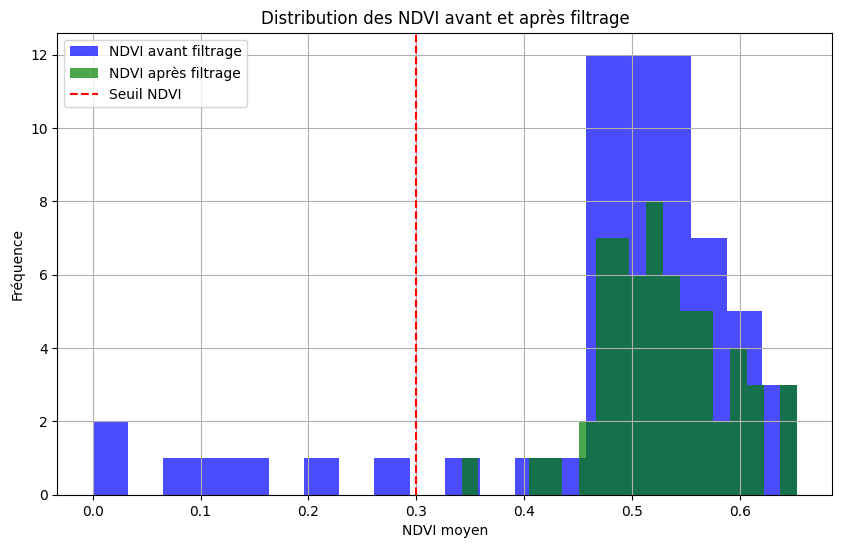

In [12]:
import matplotlib.pyplot as plt

def plot_ndvi_histogram(ndvi_means, filtered_ndvi_means=None, threshold=None):
    plt.figure(figsize=(10, 6))
    plt.hist(ndvi_means, bins=20, alpha=0.7, label='NDVI avant filtrage', color='blue')
    
    if filtered_ndvi_means is not None:
        plt.hist(filtered_ndvi_means, bins=20, alpha=0.7, label='NDVI après filtrage', color='green')
    
    if threshold is not None:
        plt.axvline(x=threshold, color='red', linestyle='--', label='Seuil NDVI')
    
    plt.xlabel("NDVI moyen")
    plt.ylabel("Fréquence")
    plt.title("Distribution des NDVI avant et après filtrage")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_ndvi_histogram(ndvi_means, filtered_ndvi_means=calculate_ndvi_means(x_filtered, bid=IDX_SEQ), threshold=ndvi_threshold)
